In [17]:
import sys
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import celltypist
import gc
import anndata
from celltypist import models
import h5py
import scipy.sparse as scs
from multiprocessing import Pool
from concurrent.futures import ThreadPoolExecutor, as_completed
from tqdm import tqdm
from adjustText import adjust_text
import scanpy.external as sce
models.download_models()


📂 Storing models in /root/.celltypist/data/models
⏩ Skipping [1/44]: Immune_All_Low.pkl (file exists)
⏩ Skipping [2/44]: Immune_All_High.pkl (file exists)
⏩ Skipping [3/44]: Adult_CynomolgusMacaque_Hippocampus.pkl (file exists)
⏩ Skipping [4/44]: Adult_Human_PancreaticIslet.pkl (file exists)
⏩ Skipping [5/44]: Adult_Human_Skin.pkl (file exists)
⏩ Skipping [6/44]: Adult_Mouse_Gut.pkl (file exists)
⏩ Skipping [7/44]: Adult_Mouse_OlfactoryBulb.pkl (file exists)
⏩ Skipping [8/44]: Adult_Pig_Hippocampus.pkl (file exists)
⏩ Skipping [9/44]: Adult_RhesusMacaque_Hippocampus.pkl (file exists)
⏩ Skipping [10/44]: Autopsy_COVID19_Lung.pkl (file exists)
⏩ Skipping [11/44]: COVID19_HumanChallenge_Blood.pkl (file exists)
⏩ Skipping [12/44]: COVID19_Immune_Landscape.pkl (file exists)
⏩ Skipping [13/44]: Cells_Fetal_Lung.pkl (file exists)
⏩ Skipping [14/44]: Cells_Intestinal_Tract.pkl (file exists)
⏩ Skipping [15/44]: Cells_Lung_Airway.pkl (file exists)
⏩ Skipping [16/44]: Developing_Human_Brain.pkl (

In [18]:
nested_dict={'B cell': {'Effector B cell': ['CD27+ effector B cell',
   'CD27- effector B cell'],
  'Memory B cell': ['Core memory B cell',
   'Early memory B cell',
   'Type 2 polarized memory B cell',
   'CD95 memory B cell',
   'Activated memory B cell'],
  'Naive B cell': ['Core naive B cell', 'ISG+ naive B cell'],
  'Plasma cell': ['Plasma cell'],
  'Transitional B cell': ['Transitional B cell']},
 'DC': {'ASDC': ['ASDC'],
  'cDC1': ['cDC1'],
  'cDC2': ['CD14+ cDC2', 'HLA-DRhi cDC2', 'ISG+ cDC2'],
  'pDC': ['pDC']},
 'Erythrocyte': {'Erythrocyte': ['Erythrocyte']},
 'ILC': {'ILC': ['ILC']},
 'Monocyte': {'CD14 monocyte': ['Core CD14 monocyte',
   'ISG+ CD14 monocyte',
   'IL1B+ CD14 monocyte'],
  'CD16 monocyte': ['Core CD16 monocyte',
   'ISG+ CD16 monocyte',
   'C1Q+ CD16 monocyte'],
  'Intermediate monocyte': ['Intermediate monocyte']},
 'NK cell': {'CD56bright NK cell': ['CD56bright NK cell'],
  'CD56dim NK cell': ['Adaptive NK cell',
   'GZMK+ CD56dim NK cell',
   'GZMK- CD56dim NK cell',
   'ISG+ CD56dim NK cell'],
  'Proliferating NK cell': ['Proliferating NK cell']},
 'Platelet': {'Platelet': ['Platelet']},
 'Progenitor cell': {'Progenitor cell': ['CMP cell',
   'CLP cell',
   'BaEoMaP cell']},
 'T cell': {'CD8aa': ['CD8aa'],
  'DN T cell': ['DN T cell'],
  'MAIT': ['CD8 MAIT', 'CD4 MAIT', 'ISG+ MAIT'],
  'Memory CD4 T cell': ['CM CD4 T cell',
   'GZMB- CD27+ EM CD4 T cell',
   'GZMB- CD27- EM CD4 T cell',
   'ISG+ memory CD4 T cell',
   'KLRF1- GZMB+ CD27- memory CD4 T cell'],
  'Memory CD8 T cell': ['GZMK+ CD27+ EM CD8 T cell',
   'CM CD8 T cell',
   'KLRF1- GZMB+ CD27- EM CD8 T cell',
   'GZMK- CD27+ EM CD8 T cell',
   'KLRF1+ GZMB+ CD27- EM CD8 T cell',
   'ISG+ memory CD8 T cell'],
  'Naive CD4 T cell': ['Core naive CD4 T cell',
   'SOX4+ naive CD4 T cell',
   'ISG+ naive CD4 T cell'],
  'Naive CD8 T cell': ['Core naive CD8 T cell',
   'SOX4+ naive CD8 T cell',
   'ISG+ naive CD8 T cell'],
  'Proliferating T cell': ['Proliferating T cell'],
  'Treg': ['Naive CD4 Treg',
   'Memory CD4 Treg',
   'KLRB1+ memory CD4 Treg',
   'Memory CD8 Treg',
   'GZMK+ memory CD4 Treg',
   'KLRB1+ memory CD8 Treg'],
  'gdT': ['GZMK+ Vd2 gdT',
   'GZMB+ Vd2 gdT',
   'Naive Vd1 gdT',
   'KLRF1+ effector Vd1 gdT',
   'SOX4+ Vd1 gdT',
   'KLRF1- effector Vd1 gdT']}}

In [19]:
def gen_mpl_labels(
    adata, groupby, exclude=(), ax=None, adjust_kwargs=None, text_kwargs=None
):
    if adjust_kwargs is None:
        adjust_kwargs = {"text_from_points": False}
    if text_kwargs is None:
        text_kwargs = {}

    medians = {}

    for g, g_idx in adata.obs.groupby(groupby).groups.items():
        if g in exclude:
            continue
        medians[g] = np.median(adata[g_idx].obsm["X_umap"], axis=0)

    if ax is None:
        texts = [
            plt.text(x=x, y=y, s=k, **text_kwargs) for k, (x, y) in medians.items()]
    else:
        texts = [ax.text(x=x, y=y, s=k, **text_kwargs) for k, (x, y) in medians.items()]

    adjust_text(texts, **adjust_kwargs)

In [38]:
def read_mat(h5_con):
    mat = scs.csc_matrix(
        (h5_con['matrix']['data'][:], # Count values
         h5_con['matrix']['indices'][:], # Row indices
         h5_con['matrix']['indptr'][:]), # Pointers for column positions
        shape = tuple(h5_con['matrix']['shape'][:]) # Matrix dimensions
    )
    return mat


def read_obs(h5con):
    bc = h5con['matrix']['barcodes'][:]
    bc = [x.decode('UTF-8') for x in bc]

    # Initialized the DataFrame with cell barcodes
    obs_df = pd.DataFrame({ 'barcodes' : bc })

    # Get the list of available metadata columns
    obs_columns = h5con['matrix']['observations'].keys()

    # For each column
    for col in obs_columns:
        # Read the values
        values = h5con['matrix']['observations'][col][:]
        # Check for byte storage
        if(isinstance(values[0], (bytes, bytearray))):
            # Decode byte strings
            values = [x.decode('UTF-8') for x in values]
        # Add column to the DataFrame
        obs_df[col] = values
    
    return obs_df
# define a function to construct anndata object from a h5 file
def read_h5_anndata(h5_file):
    h5_con = h5py.File(h5_file, mode = 'r')
    # extract the expression matrix
    mat = read_mat(h5_con)
    # extract gene names
    genes = h5_con['matrix']['features']['name'][:]
    genes = [x.decode('UTF-8') for x in genes]
    # extract metadata
    obs_df = read_obs(h5_con)
    # construct anndata
    adata = anndata.AnnData(mat.T,
                             obs = obs_df)
    # make sure the gene names aligned
    adata.var_names = genes

    adata.var_names_make_unique()
    return adata
def get_last_pattern(inputstr):
    pattern = r"[^/]+(?=$)"
    match = re.search(pattern, inputstr)
    if match:
        return match.group(0)
    else:
        return ""
def process_file(file_name):
    adata = read_h5_anndata(file_name)

    doublet_scores=pd.read_csv('/home/jupyter/BRI_Analysis/scRNA/Analysis-Cross-Sectional/TEAseq/Doublet_Scores/'+adata.obs['pbmc_sample_id'][0]+'.csv', index_col=0)
    L1_labels=pd.read_csv('/home/jupyter/BRI_Analysis/scRNA/Analysis-Cross-Sectional/TEAseq/Labels/'+adata.obs['pbmc_sample_id'][0]+'_L1_predicted_labels.csv', index_col=0)
    L2_labels=pd.read_csv('/home/jupyter/BRI_Analysis/scRNA/Analysis-Cross-Sectional/TEAseq/Labels/'+adata.obs['pbmc_sample_id'][0]+'_L2_predicted_labels.csv', index_col=0)
    L3_labels=pd.read_csv('/home/jupyter/BRI_Analysis/scRNA/Analysis-Cross-Sectional/TEAseq/Labels/'+adata.obs['pbmc_sample_id'][0]+'_L3_predicted_labels.csv', index_col=0)
    L3_5_labels=pd.read_csv('/home/jupyter/BRI_Analysis/scRNA/Analysis-Cross-Sectional/TEAseq/Labels/'+adata.obs['pbmc_sample_id'][0]+'_L3.5_predicted_labels.csv', index_col=0)
    L1_labels.columns=[ 'barcodes', 'AIFI_L1']
    L2_labels.columns=[ 'barcodes', 'AIFI_L2']
    L3_labels.columns=[ 'barcodes', 'AIFI_L3']
    L3_5_labels.columns=[ 'barcodes', 'AIFI_L3.5']
    print(doublet_scores['barcodes'].tolist()==adata.obs['barcodes'].tolist(),
          L1_labels['barcodes'].tolist()==adata.obs['barcodes'].tolist(),
          L2_labels['barcodes'].tolist()==adata.obs['barcodes'].tolist(),
          L3_labels['barcodes'].tolist()==adata.obs['barcodes'].tolist(),
          L3_5_labels['barcodes'].tolist()==adata.obs['barcodes'].tolist())
    adata.obs= pd.merge(adata.obs, doublet_scores, on='barcodes', how='left')
    adata.obs= pd.merge(adata.obs, L1_labels, on='barcodes', how='left')
    adata.obs= pd.merge(adata.obs, L2_labels, on='barcodes', how='left')
    adata.obs= pd.merge(adata.obs, L3_labels, on='barcodes', how='left')
    adata.obs= pd.merge(adata.obs, L3_5_labels, on='barcodes', how='left')
    adata.obs.index=adata.obs['barcodes']
    adata.var["mito"] = adata.var_names.str.startswith("MT-")
    adata=adata[adata.obs['predicted_doublet']==False]
    sc.pp.calculate_qc_metrics(adata, qc_vars=["mito"], inplace=True)
    #adata=adata[(adata.obs["pct_counts_mito"] <10) & (adata.obs["n_genes"] <5000) &(adata.obs["n_genes"] >200) ]
    #adata.write_h5ad('h5ad_flu_after_qc/'+adata.obs['pbmc_sample_id'][0]+'.h5ad')
    return adata
def process_file(file_name):
    adata = read_h5_anndata(file_name)

    doublet_scores=pd.read_csv('/home/jupyter/BRI_Analysis/scRNA/Analysis-Cross-Sectional/TEAseq/Doublet_Scores/'+adata.obs['pbmc_sample_id'][0]+'.csv', index_col=0)
    L1_labels=pd.read_csv('/home/jupyter/BRI_Analysis/scRNA/Analysis-Cross-Sectional/TEAseq/Labels_CertPro/'+adata.obs['pbmc_sample_id'][0]+'_L1_predicted_labels.csv', index_col=0)
    L2_labels=pd.read_csv('/home/jupyter/BRI_Analysis/scRNA/Analysis-Cross-Sectional/TEAseq/Labels_CertPro/'+adata.obs['pbmc_sample_id'][0]+'_L2_predicted_labels.csv', index_col=0)
    L3_labels=pd.read_csv('/home/jupyter/BRI_Analysis/scRNA/Analysis-Cross-Sectional/TEAseq/Labels_CertPro/'+adata.obs['pbmc_sample_id'][0]+'_L3_predicted_labels.csv', index_col=0)
    L1_labels.columns=[ 'barcodes', 'AIFI_L1']
    L2_labels.columns=[ 'barcodes', 'AIFI_L2']
    L3_labels.columns=[ 'barcodes', 'AIFI_L3']
    print(doublet_scores['barcodes'].tolist()==adata.obs['barcodes'].tolist(),
          L1_labels['barcodes'].tolist()==adata.obs['barcodes'].tolist(),
          L2_labels['barcodes'].tolist()==adata.obs['barcodes'].tolist(),
          L3_labels['barcodes'].tolist()==adata.obs['barcodes'].tolist())
    adata.obs= pd.merge(adata.obs, doublet_scores, on='barcodes', how='left')
    adata.obs= pd.merge(adata.obs, L1_labels, on='barcodes', how='left')
    adata.obs= pd.merge(adata.obs, L2_labels, on='barcodes', how='left')
    adata.obs= pd.merge(adata.obs, L3_labels, on='barcodes', how='left')
    adata.obs.index=adata.obs['barcodes']
    adata.var["mito"] = adata.var_names.str.startswith("MT-")
    #adata=adata[adata.obs['predicted_doublet']==False]
    sc.pp.calculate_qc_metrics(adata, qc_vars=["mito"], inplace=True)
    #adata=adata[(adata.obs["pct_counts_mito"] <10) & (adata.obs["n_genes"] <5000) &(adata.obs["n_genes"] >200) ]
    #adata.write_h5ad('h5ad_flu_after_qc/'+adata.obs['pbmc_sample_id'][0]+'.h5ad')
    return adata

In [39]:
meta_data=pd.read_csv('meta_data_GEO.csv')
file_list=[x+'.h5' for x in meta_data['combined_sample_id']]


In [40]:
%%time
file_names= file_list
h5_list = []
with ThreadPoolExecutor(max_workers=16) as executor:
    future_to_file = {executor.submit(process_file, file_name): file_name for file_name in file_names}
    for future in tqdm(as_completed(future_to_file), total=len(file_names)):
        result = future.result()
        if result is not None:
            h5_list.append(result)

  0% 0/16 [00:00<?, ?it/s]

True True True True
True True True True
True True True True
True True True True
True True True True
True True True True
True True True True


  6% 1/16 [00:13<03:21, 13.44s/it]

True True True True
True True True True
True True True True
True True True True
True True True True
True True True True
True True True True
True True True True


 12% 2/16 [00:15<01:34,  6.77s/it]

True True True True


100% 16/16 [00:23<00:00,  1.50s/it]

CPU times: user 46.3 s, sys: 13.4 s, total: 59.7 s
Wall time: 24 s


In [41]:
combined= anndata.concat(h5_list)

In [42]:
combined.obs[['barcodes','pbmc_sample_id','AIFI_L1','AIFI_L2','AIFI_L3','predicted_doublet','doublet_score']].to_csv('PedSenior_TEAseq_Labels_2024-03-26.csv')

In [43]:
combined.obs[['predicted_doublet']].value_counts()

predicted_doublet
False                350103
True                   3065
Name: count, dtype: int64

... storing 'adt_qc_flag' as categorical
... storing 'batch_id' as categorical
... storing 'cell_name' as categorical
... storing 'chip_id' as categorical
... storing 'hto_barcode' as categorical
... storing 'hto_category' as categorical
... storing 'original_barcodes' as categorical
... storing 'pbmc_sample_id' as categorical
... storing 'pool_id' as categorical
... storing 'seurat_pbmc_type' as categorical
... storing 'well_id' as categorical
... storing 'AIFI_L1' as categorical
... storing 'AIFI_L2' as categorical
... storing 'AIFI_L3' as categorical


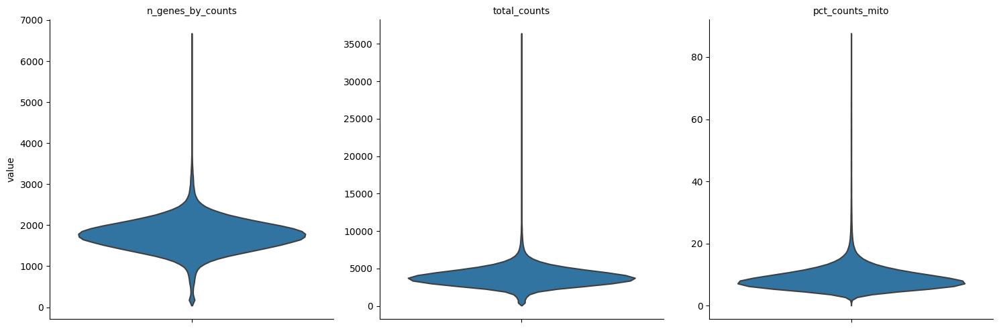

In [24]:
sc.pl.violin(
    combined,
    ["n_genes_by_counts", "total_counts", "pct_counts_mito"], stripplot=False,
    jitter=0.4,
    multi_panel=True,
)

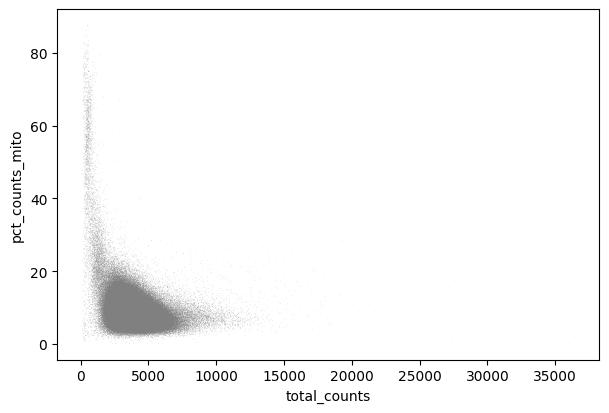

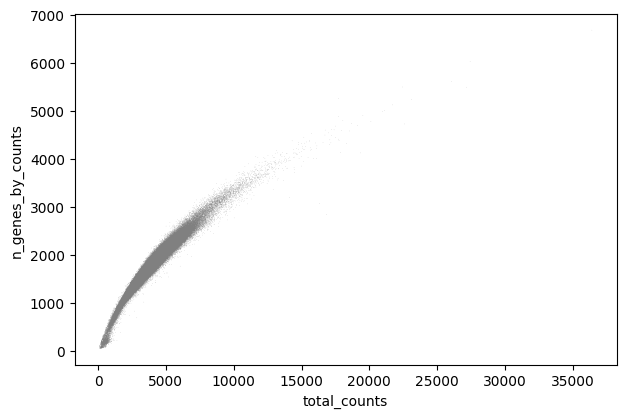

In [25]:
sc.pl.scatter(combined, x="total_counts", y="pct_counts_mito")
sc.pl.scatter(combined, x="total_counts", y="n_genes_by_counts")

In [26]:
combined=combined[(combined.obs["pct_counts_mito"] <20) & (combined.obs["n_genes_by_counts"] <3000) &(combined.obs["n_genes"] >200) ]


In [27]:
sc.pp.normalize_total(combined, target_sum=1e4)
sc.pp.log1p(combined)
sc.pp.highly_variable_genes(combined, min_mean=0.0125, max_mean=3, min_disp=0.5)
combined.raw = combined
combined = combined[:, combined.var.highly_variable]
sc.pp.scale(combined, max_value=10)


In [28]:
sc.tl.pca(combined, svd_solver="arpack")

In [29]:
sce.pp.harmony_integrate(combined, 'batch_id',max_iter_harmony = 20)
sc.pp.neighbors(combined, n_neighbors=50,use_rep='X_pca_harmony', n_pcs=30)
sc.tl.umap(combined)

2024-03-26 22:33:00,361 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
Computing initial centroids with sklearn.KMeans...
2024-03-26 22:35:00,859 - harmonypy - INFO - sklearn.KMeans initialization complete.
sklearn.KMeans initialization complete.
2024-03-26 22:35:02,119 - harmonypy - INFO - Iteration 1 of 20
Iteration 1 of 20
2024-03-26 22:37:22,303 - harmonypy - INFO - Iteration 2 of 20
Iteration 2 of 20
2024-03-26 22:39:42,064 - harmonypy - INFO - Iteration 3 of 20
Iteration 3 of 20
2024-03-26 22:42:07,270 - harmonypy - INFO - Converged after 3 iterations
Converged after 3 iterations


  0%|          | 0/200 [00:00<?, ?it/s]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs


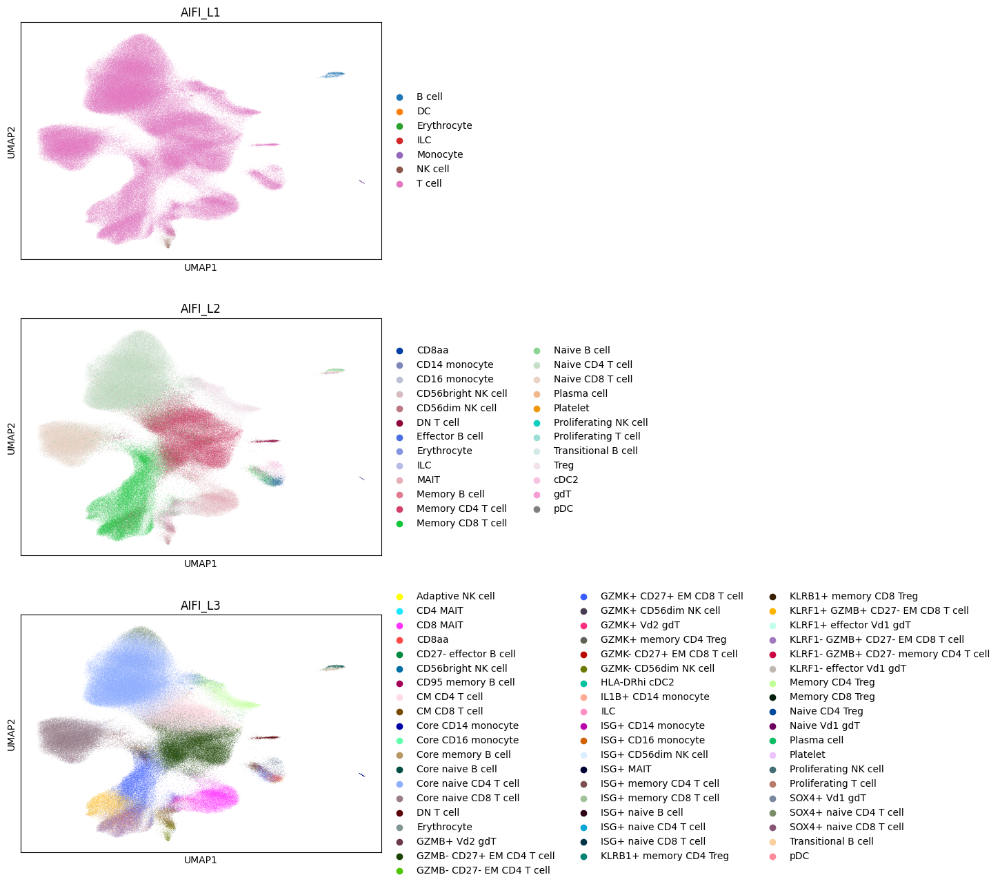

In [30]:
sc.pl.umap(combined, color=["AIFI_L1","AIFI_L2","AIFI_L3"],ncols=1)


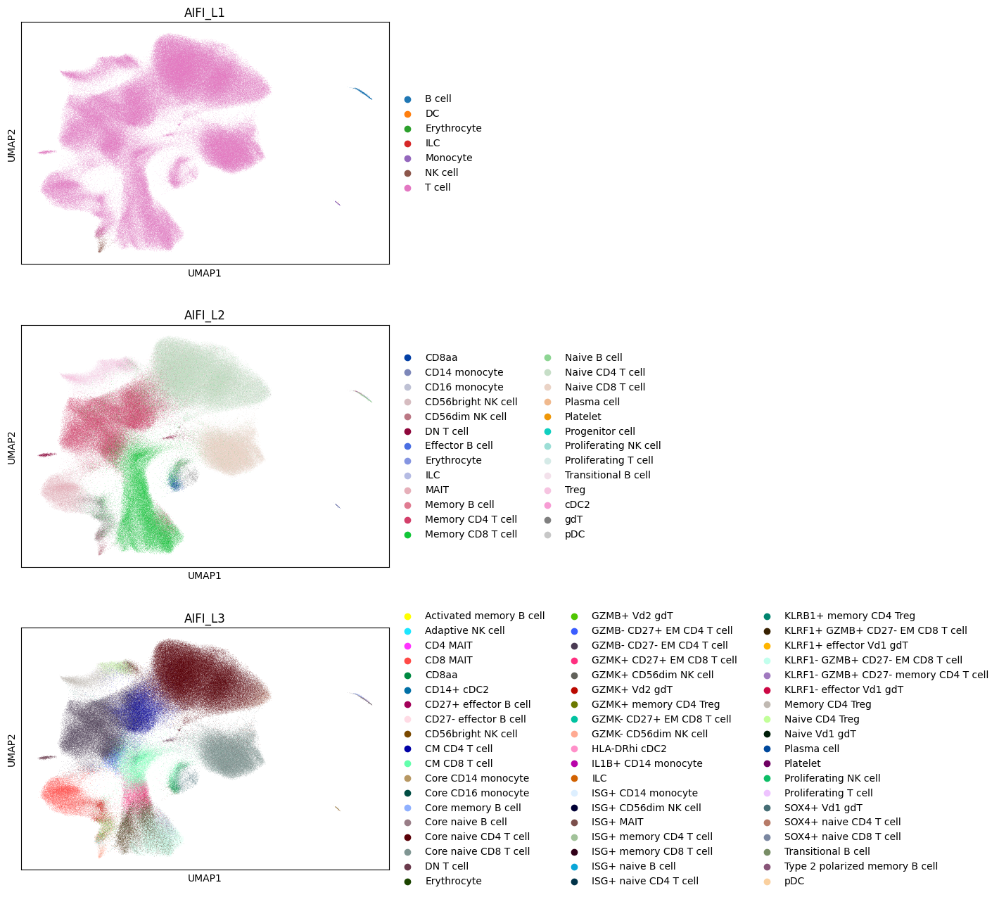

In [15]:
sc.pl.umap(combined, color=["AIFI_L1","AIFI_L2","AIFI_L3"],ncols=1)


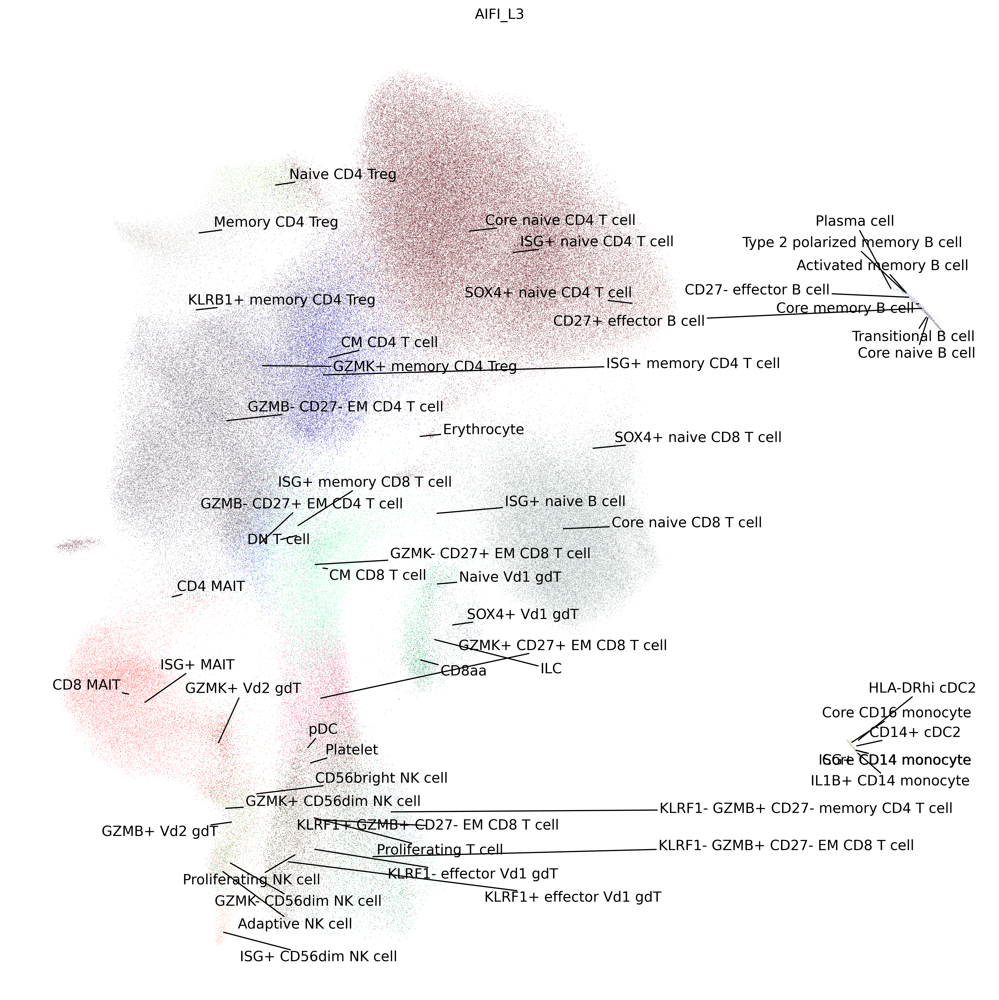

In [19]:
with plt.rc_context({"figure.figsize": (12, 12), "figure.dpi": 500, "figure.frameon": False}):
    ax=sc.pl.umap(combined, color=['AIFI_L3'], size=0.5,show=False,legend_loc=None,ncols=1 ,frameon=False)
    gen_mpl_labels(
        combined,
        'AIFI_L3',
        exclude=(""),
        ax=ax,
        adjust_kwargs=dict(arrowprops=dict(arrowstyle='-', color='black')),
        text_kwargs=dict(fontsize=12),)
    fig = ax.get_figure()
    fig.tight_layout()


... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing 'cluster_dummy' as categorical
... storing

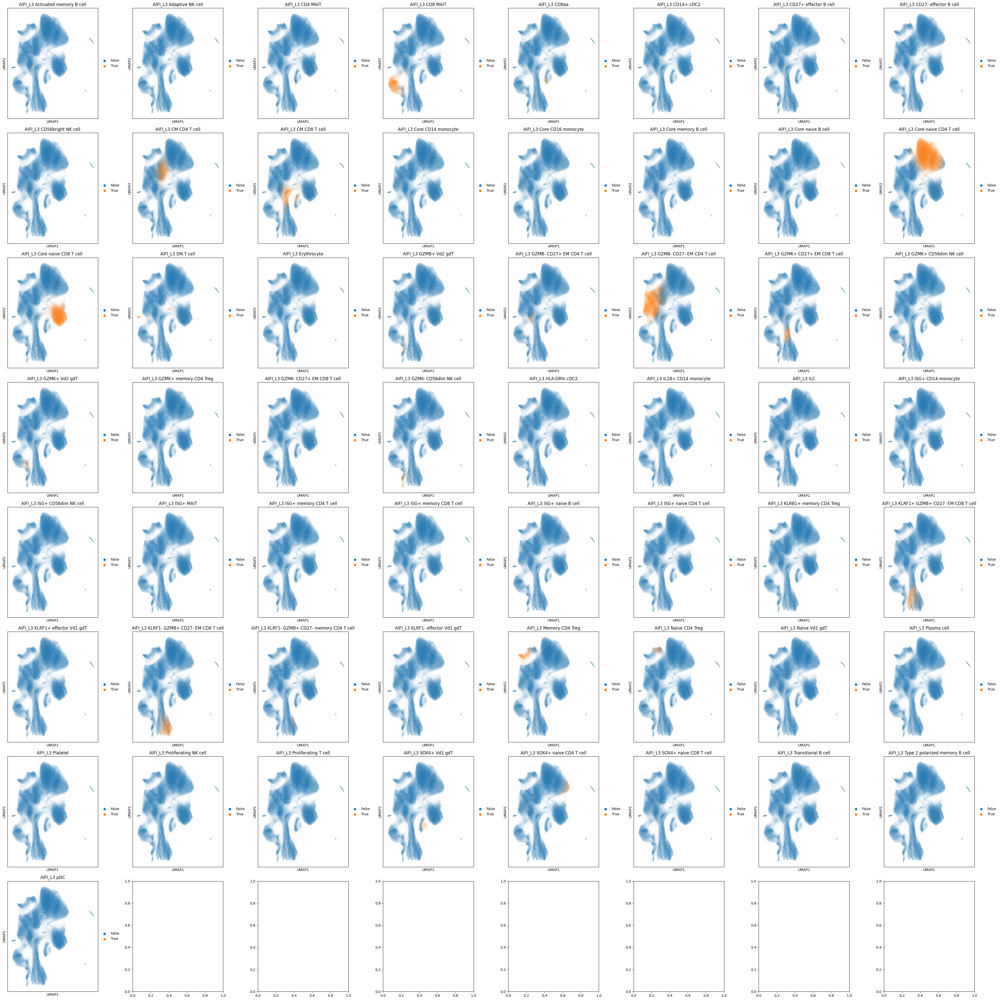

In [17]:
import math
AIFI_L3_categories = combined.obs['AIFI_L3'].cat.categories

n_categories = len(AIFI_L3_categories)

n_columns = 8
n_rows = math.ceil(n_categories / n_columns)

fig, axs = plt.subplots(n_rows, n_columns, figsize=(5 * n_columns, 5 * n_rows))

for i, category in enumerate(AIFI_L3_categories):
    row = i // n_columns
    col = i % n_columns
    combined.obs['cluster_dummy'] = combined.obs['AIFI_L3'] == category
    combined.obs['cluster_dummy']=[str(item) for item in combined.obs['cluster_dummy']]
    sc.pl.umap(combined, color='cluster_dummy', title=f'AIFI_L3 {category}', ax=axs[row, col], show=False)

plt.tight_layout()
plt.show()

In [20]:
combined.obs['AIFI_L3'].value_counts()

AIFI_L3
Core naive CD4 T cell                   112834
GZMB- CD27- EM CD4 T cell                59414
Core naive CD8 T cell                    46738
CM CD4 T cell                            22669
CD8 MAIT                                 17031
CM CD8 T cell                            16558
KLRF1- GZMB+ CD27- EM CD8 T cell         15637
KLRF1+ GZMB+ CD27- EM CD8 T cell         13656
GZMK+ CD27+ EM CD8 T cell                 6945
Memory CD4 Treg                           6478
SOX4+ naive CD4 T cell                    3842
GZMB- CD27+ EM CD4 T cell                 2786
Naive CD4 Treg                            2660
GZMK- CD56dim NK cell                     2593
GZMK+ Vd2 gdT                             2188
SOX4+ Vd1 gdT                             2152
DN T cell                                 1397
CD8aa                                     1205
GZMB+ Vd2 gdT                             1125
KLRF1- GZMB+ CD27- memory CD4 T cell      1061
Core naive B cell                          547
Naive

In [26]:
combined=combined.raw.to_adata()
combined.raw=combined

In [27]:
sc.pp.normalize_total(combined, target_sum=1e4)
sc.pp.log1p(combined)

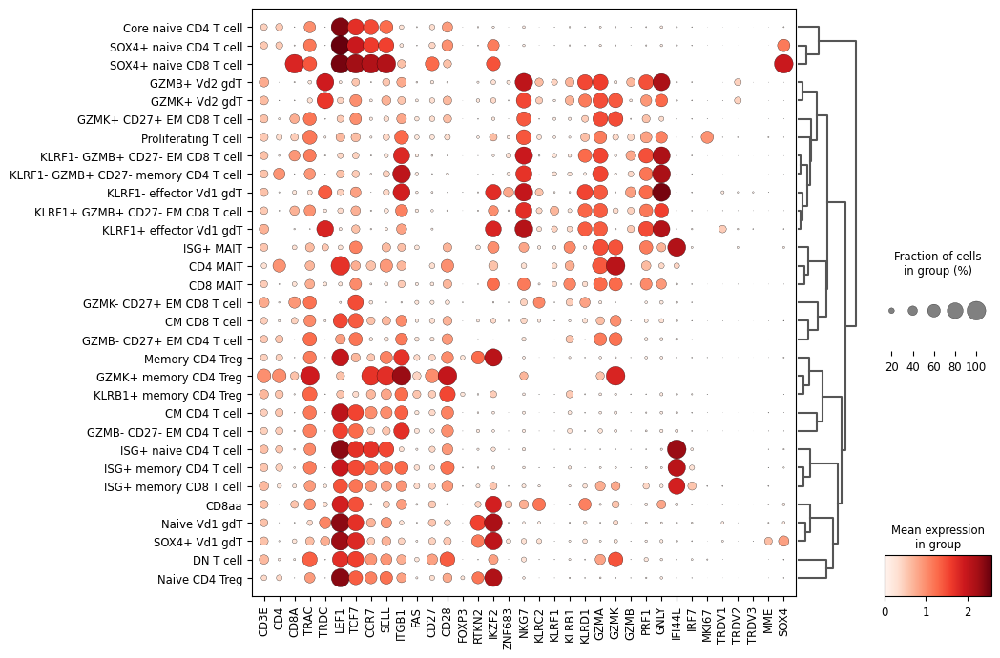

In [28]:
genelist='CD3E, CD4, CD8A, TRAC, TRDC, LEF1, TCF7, CCR7, SELL, ITGB1, FAS, CD27, CD28, FOXP3, RTKN2, IKZF2, ZNF683, NKG7, KLRC2, KLRF1, KLRB1, KLRD1, GZMA, GZMK, GZMB, PRF1, GNLY, IFI44L, IRF7, MKI67, TRDV1, TRDV2, TRDV3, MME, SOX4'
genelist=genelist.split(', ')
adata_subset=combined[combined.obs['AIFI_L3'].isin([item for sublist in nested_dict['T cell'].values() for item in sublist])]
sc.pl.dotplot(adata_subset, genelist, 'AIFI_L3', use_raw=False, dendrogram=True,figsize=(10,8))